#0️⃣ Import Libraries & Defining Constants

##### Mount GoogleDrive

In [ ]:
!fusermount -u drive # 👈 unmounting
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


##### Import the usual suspects ... 👻🧛‍♀️🧟

In [ ]:
!pip install -Uqq fastbook
import fastbook
fastbook.setup_book()
from fastbook import *
from fastai.vision.widgets import *

Mounted at /content/gdrive


##### And some new friends ... 🧞‍♀️🧚‍♂️🦄

In [ ]:
import os
from fastai.metrics import error_rate, accuracy
import random
import shutil
import pathlib
import numpy as np

##### Defining Constants 🗿🪦

In [ ]:
# Defining Constants
BASE_FOLDER = "/content/gdrive/My Drive/fastai/unpackai/flowers"
PATH_TO_TRAIN = BASE_FOLDER+"/training/"
PATH_TO_TEST = BASE_FOLDER+"/testing/"
PATH_TO_MODELS = BASE_FOLDER+"/models/"
CATEGORIES = ["daisy","dandelion","rose","sunflower","tulip"]

#1️⃣  Some Prework

## Building a Test Dataset

In `Flower Categorization.ipynb` I missed a build to test dateset. I will do this now by manually creating two folders `training` and `testing` within my `flowers` folder on my _Google Drive_, I moved all the folders containing the flower images into the training folder, built the same flower categories as folders within the `testing` folder. 
I then moved a sample of all the images from my training folder to the testing folder with the following code:
```
def create_testset(src_folder ,dest_folder,test=0.2):
  files = os.listdir(src_folder)
  no_of_files = int(len(files) * test)

  #Move files
  for file_name in random.sample(files, no_of_files):
    shutil.move(os.path.join(src_folder, file_name), dest_folder)

for flower in CATEGORIES:
  src = PATH_TO_TRAIN+flower
  dst = PATH_TO_TEST+flower
  create_testset(src, dst,test=0.2)
```

In [ ]:
print("TRAINING\n=======")
for flower in CATEGORIES:
  src = PATH_TO_TRAIN + flower
  print(flower,": ",len(Path(src).ls()))

print("\nTESTING\n=======")
for flower in CATEGORIES:
  src = PATH_TO_TEST + flower
  print(flower,": ",len(Path(src).ls()))

TRAINING
daisy :  616
dandelion :  787
rose :  628
sunflower :  586
tulip :  780

TESTING
daisy :  154
dandelion :  196
rose :  156
sunflower :  146
tulip :  195


## Load the **old** Training Results

In [ ]:
# I saved the training results but forgot to copy it to my GDrive 😌. 
#Anyhow, the best Accuracy I got was around 85% - This is the benchmark I need to beat 💪🏻

#learn4.load('flower-stage-4')

# 2️⃣ Getting the Data

In [ ]:
#PATH_TO_TRAIN
path = Path(PATH_TO_TRAIN)
path.ls()

(#6) [Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/tulip'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/dandelion'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/daisy'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/sunflower'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/.ipynb_checkpoints')]

In [ ]:
for flower in CATEGORIES:
  x = os.listdir(PATH_TO_TRAIN+flower)
  print(flower,": ",len(x))

daisy :  616
dandelion :  787
rose :  628
sunflower :  586
tulip :  780


# 3️⃣ Prepare for Training

In [ ]:
# CREATE LIST OF PATH TO TRAINING IMAGES
fns = get_image_files(PATH_TO_TRAIN)
fns

(#3393) [Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/16051111039_0f0626a241_n.jpg'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/22982871191_ec61e36939_n.jpg'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/15972976206_d32feeb79b_n.jpg'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/14408977935_a397e796b8_m.jpg'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/12338444334_72fcc2fc58_m.jpg'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/16424992340_c1d9eb72b4.jpg'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/4061451210_1650590c6a.jpg'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/3751835302_d5a03f55e8_n.jpg'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/32724693914_282ccc4f92_n.jpg'),Path('/content/gdrive/My Drive/fastai/unpackai/flowers/training/rose/2536282942_b5ca27577e.jpg').

In [ ]:
%%time
# CHECK IMAGES FOR BROKEN FILES
# ⏳ Takes longer to run
#failed = verify_images(fns)
#failed

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 5.48 µs


## DataBlock

In [ ]:
flowers = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.25, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128))

## DataLoader

In [ ]:
dls = flowers.dataloaders(PATH_TO_TRAIN)
dls_test = flowers.dataloaders(PATH_TO_TEST)

## Investigate Dataset

In [ ]:
#Show labels
dls.vocab

['daisy', 'dandelion', 'rose', 'sunflower', 'tulip']

In [ ]:
# Size of Datasets
print("TRAINING TEST SIZES:")
print("Total: ", dls.n)
print("Train: ", dls.n-dls.valid.n)
print("Validation: ", dls.valid.n)

TRAINING TEST SIZES:
Total:  2545
Train:  1697
Validation:  848


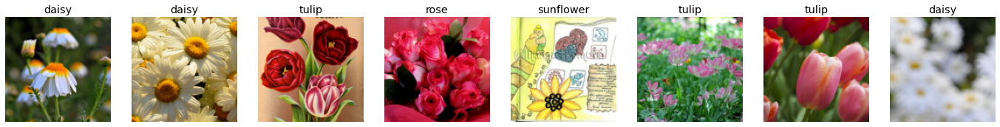

In [ ]:
dls.valid.show_batch(max_n=8, nrows=1)

# 4️⃣ Train

Metrics = Accuracy, because all groups ca same size

### 🔍 Saved Models Overview
|No| NAME      | MODEL PARAMETER | DATABLOCK | BEST EPOCH | ACCURACY |
| -- | ----------- | ----------- | --- | --- | ---- |
|0| flower_1a      | `arch=resnet34`   |    | 2 | 0.84 |
|1| flower_1b   | `arch=resnet50`     |   | 19 | 0.89 |  
|2|   | `arch=resnet50`<br>`base_lr=lr_min`   |   |  | 0.86 | 
|3| flower_1c | `arch=resnet50` |  item_tfms=Resize(256)| 18 | 0.93 |
|4|flower_1d|`arch=resnet50`|`item_tfms=(RandomResizedCrop(256, min_scale=0.35)),` <br> `batch_tfms=aug_transforms(mult=2)`| 19 | 0.95|
|5|flower_1e|`arch=resnet50`|Normalization| 19 | 0.95|

## 0️⃣ Old Training Cycle: resnet34 👍

In [ ]:
%%time
learn = cnn_learner(dls=dls, arch=resnet34, metrics=accuracy)
learn.fit_one_cycle(4)

epoch,train_loss,valid_loss,accuracy,time
0,1.540981,0.610043,0.773585,00:16
1,0.925402,0.512410,0.827830,00:16
2,0.654061,0.457857,0.843160,00:16
3,0.493504,0.456547,0.846698,00:16


CPU times: user 15.6 s, sys: 1.56 s, total: 17.1 s
Wall time: 1min 7s


>👆🏼 This is the benchmark I have to beat 🎯🥊

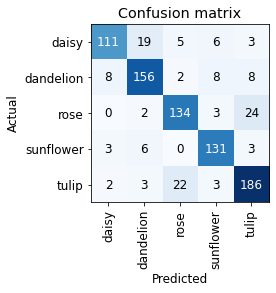

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

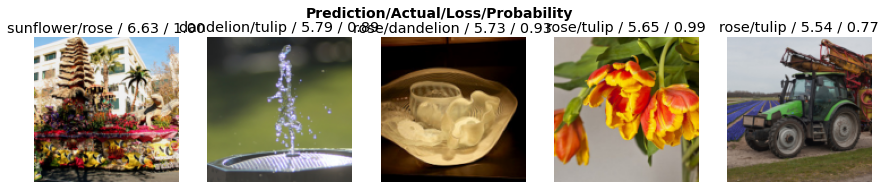

In [ ]:
# SHOW TOP 5 MISCLASSIFIED IMAGES
interp.plot_top_losses(5, nrows=1)

In [ ]:
# SAVE & LOAD MODEL (UNCOMMENT DESIRED)
learn.save(PATH_TO_MODELS + '/flower_1a')
#learn.load(PATH_TO_MODELS + '/flower_1a')

Path('/content/gdrive/My Drive/fastai/unpackai/flowers/models/flower_1a.pth')

## 1️⃣ New Training Cycle: `resnet50` and longer training

In [ ]:
# load resnet34 model
learn.load(PATH_TO_MODELS + '/flower_1a')

In [ ]:
learn = cnn_learner(dls, resnet50, metrics=accuracy)
learn.fit_one_cycle(20) #I checked eopoch=20 but 19 was best

epoch,train_loss,valid_loss,accuracy,time
0,1.641093,0.688474,0.755896,00:18
1,1.015273,0.540087,0.813679,00:18
2,0.694151,0.524544,0.837264,00:18
3,0.510648,0.532615,0.838443,00:18
4,0.383808,0.556044,0.831368,00:18
5,0.317171,0.553483,0.844340,00:18
6,0.229155,0.480155,0.859670,00:18
7,0.175599,0.489543,0.864387,00:17
8,0.136901,0.539412,0.865566,00:18
9,0.107968,0.523926,0.860849,00:18


In [ ]:
# SAVE MODEL (UNCOMMENT DESIRED)
learn.save(PATH_TO_MODELS + '/flower_1b')

Path('/content/gdrive/My Drive/fastai/unpackai/flowers/models/flower_1b.pth')

## 2️⃣ New Training Cycle: Find optimal hyperparameter 👎🏻

In [ ]:
# LOAD PREVIOUS MODEL (UNCOMMENT DESIRED)
learn.load(PATH_TO_MODELS + '/flower_1b')

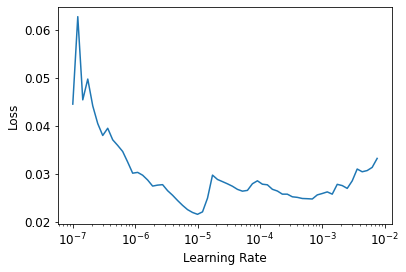

In [ ]:
lr_min, lr_steep = learn.lr_find()

In [ ]:
print(f"Minim/10: {lr_min:.2e}, steepest point: {lr_steep:.2e}")

Minim/10: 1.00e-06, steepest point: 7.59e-07


In [ ]:
# Finetune with minimum learning rate
learn.fine_tune(epochs=2, base_lr=lr_min)

epoch,train_loss,valid_loss,accuracy,time
0,0.029291,0.514919,0.866745,00:17


epoch,train_loss,valid_loss,accuracy,time
0,0.028583,0.528566,0.867925,00:18
1,0.027363,0.517406,0.859670,00:18


> This did not bring any improvment: let's keep the default learning rate!

##3️⃣ New Training Cycle: change image size 👍

In [ ]:
# LOAD PREVIOUS MODEL (UNCOMMENT DESIRED)
#learn.load(PATH_TO_MODELS + '/flower_1b')

# DataBlock
flowers = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.25, seed=42),
    get_y=parent_label,
    item_tfms=Resize(256)) # 👈 changed!
# DataLoader
dls = flowers.dataloaders(PATH_TO_TRAIN)

In [ ]:
%%time
learn2 = cnn_learner(dls=dls, arch=resnet50, metrics=accuracy)
learn2.fit_one_cycle(20)

epoch,train_loss,valid_loss,accuracy,time
0,1.368746,0.425127,0.850236,00:35
1,0.735890,0.335120,0.882075,00:35
2,0.477259,0.331059,0.896226,00:35
3,0.332751,0.325810,0.903302,00:35
4,0.254248,0.360545,0.904481,00:35
5,0.190776,0.348506,0.899764,00:35
6,0.140587,0.367975,0.919811,00:35
7,0.097439,0.371187,0.904481,00:35
8,0.077251,0.354793,0.919811,00:35
9,0.063513,0.361446,0.915094,00:35


CPU times: user 5min 31s, sys: 4min 25s, total: 9min 57s
Wall time: 11min 57s


In [ ]:
# SAVE & LOAD MODEL (UNCOMMENT DESIRED)
learn2.save(PATH_TO_MODELS + '/flower_1c')

Path('/content/gdrive/My Drive/fastai/unpackai/flowers/models/flower_1c.pth')

## 4️⃣ New Training Cycle: Data Augmentation 👍  

In [ ]:
# LOAD THE BEST MODEL
learn2.load(PATH_TO_MODELS + '/flower_1c')

>Make sure that `learn2` is loaded
- otherwise: go back to Chapter *Change Image Size* and reload `learn2`


In [ ]:
# CHECK IF DATABLOCK AND DATALOADER ARE LOADED
if learn2: print("learn2 is loaded - you're ready to go ✅") 
else: print("you need to load learn2 first 🚫")

learn2 is loaded - you're ready to go ✅


In [ ]:
# add random sized cropped images

# Change DataBlock
flowers2=flowers.new(item_tfms=(RandomResizedCrop(256, min_scale=0.35)),
            batch_tfms=aug_transforms(mult=2))
# DataLoader
dls2 = flowers2.dataloaders(PATH_TO_TRAIN)

In [ ]:
%%time
learn2 = cnn_learner(dls=dls2, arch=resnet50, metrics=accuracy)
learn2.fine_tune(20)

epoch,train_loss,valid_loss,accuracy,time
0,0.977287,0.523025,0.884434,00:37


epoch,train_loss,valid_loss,accuracy,time
0,0.443550,0.367064,0.908019,00:46
1,0.349229,0.355337,0.905660,00:46
2,0.283153,0.291493,0.916274,00:46
3,0.252086,0.349431,0.910377,00:46
4,0.239316,0.284095,0.929245,00:46
5,0.203785,0.337358,0.911557,00:46
6,0.170385,0.363783,0.906840,00:46
7,0.148083,0.300947,0.922170,00:46
8,0.149892,0.260880,0.936321,00:46
9,0.129948,0.358625,0.918632,00:46


CPU times: user 7min 26s, sys: 6min 41s, total: 14min 7s
Wall time: 16min 10s


In [ ]:
# SAVE MODEL
learn2.save(PATH_TO_MODELS + '/flower_1d')

Path('/content/gdrive/My Drive/fastai/unpackai/flowers/models/flower_1d.pth')

## 5️⃣ New Training Cycle: Normalization Input Data 👎🏻

>"*... normalization becomes especially important when using pretrained models.*" (Jeremy Howard (2019): *Deep Learning for Coders with fastai and PyTorch*)

So I was wondering if **normalization** might increase the accuracy. I gave it a try:

In [ ]:
def get_dls(bs, size):
    dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                       get_items=get_image_files,
                   get_y=parent_label,
                   item_tfms=Resize(460),
                   batch_tfms=[*aug_transforms(size=size, min_scale=0.75),
                               Normalize.from_stats(*imagenet_stats)])
    return dblock.dataloaders(path, bs=bs)
dls3 = get_dls(64, 224)

In [ ]:
%%time
learn3 = cnn_learner(dls=dls3, arch=resnet50, metrics=accuracy)
learn3.fine_tune(20)

epoch,train_loss,valid_loss,accuracy,time
0,0.895280,0.448588,0.892330,00:35


epoch,train_loss,valid_loss,accuracy,time
0,0.375619,0.286797,0.920354,00:42
1,0.268500,0.236564,0.924779,00:42
2,0.197797,0.240905,0.921829,00:42
3,0.162209,0.327786,0.912979,00:43
4,0.153562,0.276167,0.933628,00:42
5,0.156589,0.294993,0.932153,00:42
6,0.121960,0.242182,0.936578,00:42
7,0.089825,0.256572,0.929204,00:42
8,0.073802,0.219652,0.946903,00:42
9,0.066795,0.232735,0.936578,00:42


CPU times: user 6min 46s, sys: 5min 22s, total: 12min 8s
Wall time: 14min 53s


>Contrary to the Literature, normalization did not improve the outcome.

##6️⃣ Fifth Training Cycle: Delete bad Images manually

In [ ]:
# LOAD LAST SUCCESSFUL MODEL
learn2.load(PATH_TO_MODELS + '/flower_1d')

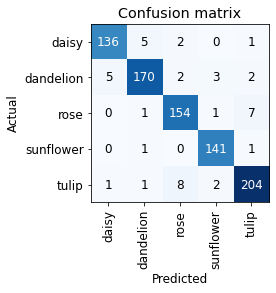

In [ ]:
interp = ClassificationInterpretation.from_learner(learn2)
interp.plot_confusion_matrix()

43 Images are wrongly classified! 👆🏼

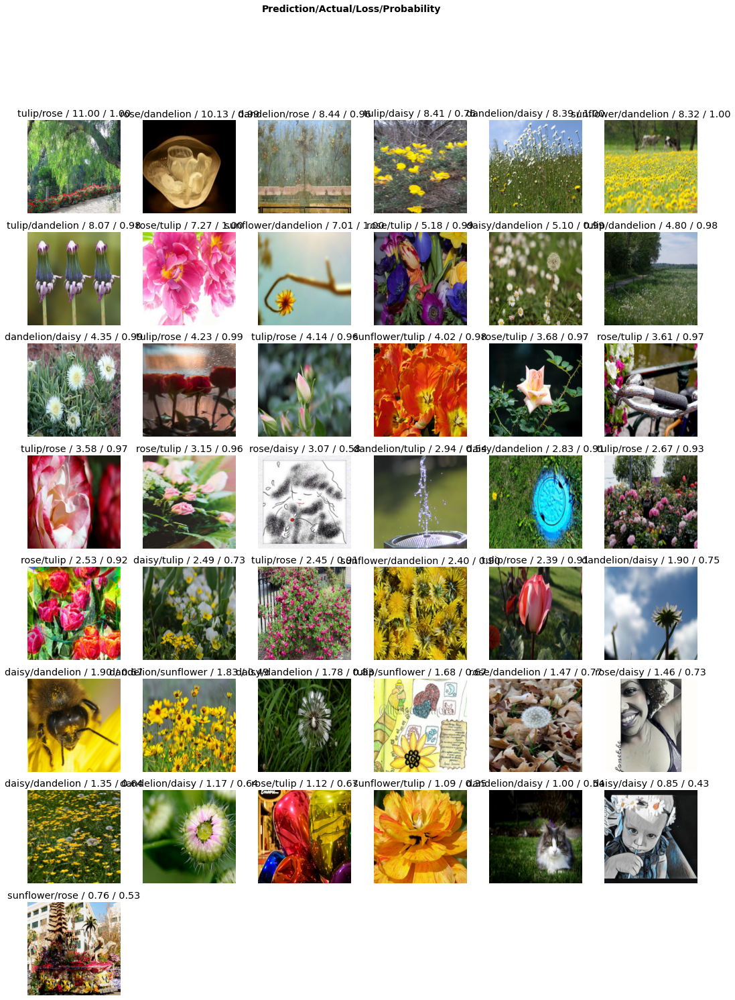

In [ ]:
interp.plot_top_losses(43, nrows=8)

It looks like most wrong classified images contain more than one flower, further more a few images does not contain any flowers at all.

In [ ]:
cleaner = ImageClassifierCleaner(learn2)
cleaner

In [ ]:
#this deletes (unlinks) the chosen images from the DataBlock
#rund this code for every flower category!!!
n=0
for idx in cleaner.delete(): 
  n+=1
  cleaner.fns[idx].unlink()

In [ ]:
print("Deleted daisy: ",n)

Deleted daisy:  8


In [ ]:
print("Deleted dandelion: ",n)

Deleted dandelion:  7


In [ ]:
print("Deleted roses: ",n)

Deleted roses:  7


In [ ]:
print("Deleted sunflowers: ",n)

Deleted sunflowers:  7


In [ ]:
print("Deleted tulip: ",n)

Deleted tulip:  10


🤷‍♂️ After deleting these images (actually: marking them - so the model will not use them any more) I received this error, indicating that the DataLoader cannot find the marked images: 

In [ ]:
learn5 = cnn_learner(dls, resnet50, metrics=accuracy)
learn5.fit_one_cycle(20)

epoch,train_loss,valid_loss,accuracy,time


UnidentifiedImageError: ignored

🤷‍♂️ I tried to delete these images from `cleaner.fns`, but without final success and without knowing what caused this error: 

In [ ]:
# Delete files from cleaner which do not exist in folder
import os.path
print("Length before: ",len(cleaner.fns))
for img in cleaner.fns:
  if not os.path.exists(img):
    cleaner.fns.remove(img)
print("Length after: ",len(cleaner.fns))

Length before:  30
Length after:  25


```
FileNotFoundError: Caught FileNotFoundError in DataLoader worker process 0.
Original Traceback (most recent call last):
...
[Errno 2] No such file or directory: '/content/gdrive/My Drive/fastai/unpackai/flowers/training/tulip/5717949231_23e2d4c297_n.jpg'
```

In [ ]:
! ls "/content/gdrive/My Drive/fastai/unpackai/flowers/training/tulip/5717949231_23e2d4c297_n.jpg"
#20183028616_beb937e75c_m.jpg

SyntaxError: ignored

##7️⃣ New Training Cycle: change image size again 🤷‍♂️

Running this learning epochs - for whatever reason - gave me the following strange message:

In [ ]:
%%time

# LOAD PREVIOUS MODEL (UNCOMMENT DESIRED)
learn2.load(PATH_TO_MODELS + '/flower_1b')

# DataBlock
flowers = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.25, seed=42),
    get_y=parent_label,
    item_tfms=Resize(400)) # 👈 changed!
# DataLoader
dls = flowers.dataloaders(PATH_TO_TRAIN)


learn2 = cnn_learner(dls=dls, arch=resnet50, metrics=accuracy)
learn2.fit_one_cycle(20)

epoch,train_loss,valid_loss,accuracy,time


RuntimeError: ignored

# 5️⃣ Final Test with Test Data

🌵🦂🐫
...
 

---




Finally, I was running out of GPU resources. And as I don't want to upgrade to `Colab Pro` at the moment, I leave for now ...

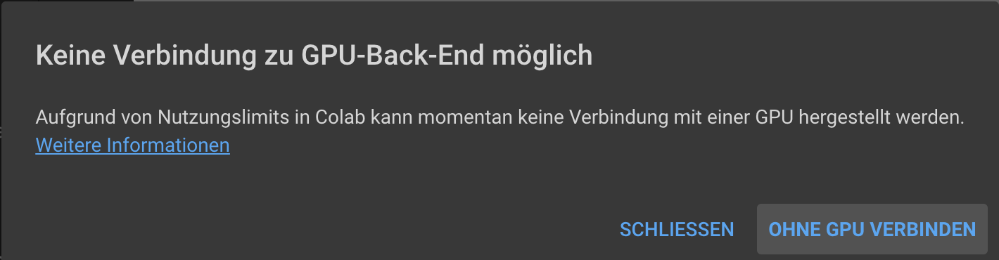